# Import packages and load data

In [1]:
import pandas as pd
import numpy as np
import sklearn
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import ParameterGrid, cross_val_score
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn import model_selection
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import GridSearchCV
from matplotlib import rc
xscaler = MinMaxScaler()

In [2]:
file_path = '../../input_data/pspeo_master.xlsx'
model_output = 'afm_domain'
# import data frame for pre-processing
df = pd.read_excel(file_path)
df.head()

,sample,solv_ratio,add_type,swell_ratio,gisaxs_domain,gisaxs_fwhm,afm_domain,afm_grain
0,I_A_AC,80/20,Chloronaphthalene,1.00,31.302630,0.003697,33.737303,0.0048
1,I_A025,80/20,Chloronaphthalene,1.25,33.805848,0.003136,35.151690,0.0047
2,I_A050,80/20,Chloronaphthalene,1.50,34.176062,0.002970,35.397797,0.0534
3,I_A075,80/20,Chloronaphthalene,1.75,34.383751,0.003451,34.603726,0.0425
4,I_A_100,80/20,Chloronaphthalene,2.00,31.674148,0.005122,33.786210,0.0244


# Data pre-processing

In [3]:
# Assign input variables and target variable, eliminating static valuesp
inputs = df.loc[:, ['solv_ratio', 'swell_ratio', 'add_type']]
target = df['afm_domain']

# Define mapping for solv_ratio
type_mapping = {100: 1.0, '90/10': 0.9, '80/20': 0.8, '70/30': 0.7, '60/40': 0.6, '50/50': 0.5}
inputs['solv_ratio'] = inputs['solv_ratio'].replace(type_mapping)

# Encode categorical input 'add_type'
le_addType = LabelEncoder()
inputs['add_type'] = le_addType.fit_transform(inputs['add_type'])

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(inputs, target, test_size=0.2, random_state=10)

# Scale the x data for better fitting
xscaler.fit(X_train)
X_train = xscaler.transform(X_train)
X_test = xscaler.transform(X_test)

# Grid-Search

In [4]:
%%time

# Define parameter grid
param_grid = {
    'n_estimators': [10, 25, 50, 75, 100],
    'criterion': ["squared_error", "friedman_mse"],
    'max_depth': [None, 5, 10, 20, 30],
    'min_samples_split': [2, 5, 10, 20],
    'max_leaf_nodes': [None, 10, 20, 30, 50],
    'max_features': ['sqrt', 'log2', 1.0],  # 1.0 = use all features
    'bootstrap': [True, False]
}

# Set seed
RANDOM_SEED = 42
CV_FOLDS = 5

# Variables to store the best results
best_model = None
best_params = None
best_avg_r2 = float('-inf')

# Loop over all combinations
for params in ParameterGrid(param_grid):
    model = RandomForestRegressor(**params, random_state=RANDOM_SEED, n_jobs=-1)
    
    # Cross-validated R² on training set
    cv_scores = cross_val_score(model, X_train, y_train, cv=CV_FOLDS, scoring='r2', n_jobs=-1)
    cv_r2 = np.mean(cv_scores)
    
    # Fit model to full training set
    model.fit(X_train, y_train)
    
    # R² on test set
    test_r2 = model.score(X_test, y_test)
    
    # Average R²: cross-val on train + test
    avg_r2 = (cv_r2 + test_r2) / 2

    if avg_r2 > best_avg_r2:
        best_avg_r2 = avg_r2
        best_model = model
        best_params = params
        best_cv_r2 = cv_r2
        best_test_r2 = test_r2

# Output the results
print("Best Average R² (CV Train + Test):", best_avg_r2)
print("CV Train R²:", best_cv_r2)
print("Test R²:", best_test_r2)
print("Best Parameters:", best_params)

Best Average R² (CV Train + Test): 0.5093684774940159
CV Train R²: 0.48620061567362355
Test R²: 0.5325363393144082
Best Parameters: {'bootstrap': False, 'criterion': 'squared_error', 'max_depth': 10, 'max_features': 'sqrt', 'max_leaf_nodes': 10, 'min_samples_split': 2, 'n_estimators': 10}
CPU times: user 3min 34s, sys: 31.4 s, total: 4min 5s
Wall time: 6min 56s


In [5]:
best = RandomForestRegressor(**best_params, random_state=42, n_jobs=-1)
best.fit(X_train, y_train)
# test_r2 = model.score(X_test, y_test)  # or use r2_score(y_test, model.predict(X_test))

RandomForestRegressor(bootstrap=False, max_depth=10, max_features='sqrt',
                      max_leaf_nodes=10, n_estimators=10, n_jobs=-1,
                      random_state=42)

In [6]:
train_r2 = best.score(X_train, y_train)
test_r2 = best.score(X_test, y_test)

print(f'Training r2: {train_r2}')
print(f'Testing r2: {test_r2}')

# Create an array for x values
x_len = len(y_test)
actual_x = np.arange(1, x_len+1)

# Define the output path for figures
output_path = f'../final_figs/{model_output}/'

Training r2: 0.6738601690665915
Testing r2: 0.5325363393144071


In [7]:
from joblib import dump, load

dump(best, f'{model_output}.joblib')

['afm_domain.joblib']

In [8]:
rfr_train = best.predict(X_train)
rfr_test = best.predict(X_test)

# Visualize the results

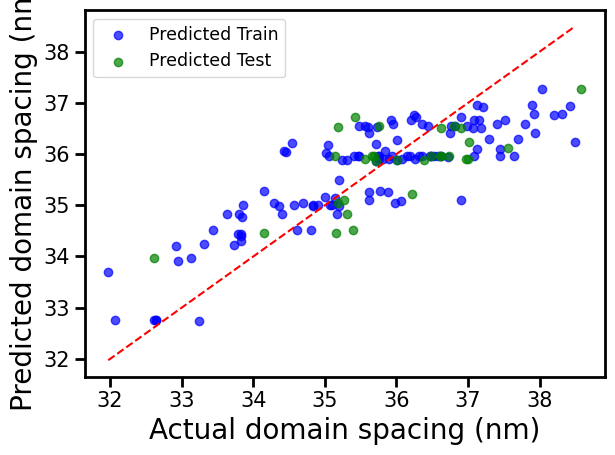

In [7]:
# Define the figure title
fig_title = f'{model_output}_avp.png'

# set formatting for plots
%matplotlib inline
# from matplotlib import cm
from matplotlib import rc
rc('text', usetex=False)
rc('mathtext', fontset='cm')
rc('xtick', labelsize=15)  
rc('xtick.major', size=7)   
rc('xtick.minor', size=4)
rc('xtick.major', width=2)
rc('xtick.minor', width=2)
rc('ytick.major', width=2)
rc('ytick.minor', width=2)
rc('ytick', labelsize=15)
rc('ytick.major', size=7)
rc('ytick.minor', size=4)
rc('axes', labelsize=15) 
rc('axes', linewidth=2) 
rc('font',family='sans serif')
rc('font', style='normal')
rc('font', weight='500')
rc('font', size='15')
rc('axes', labelweight='500')
rc('axes.spines', **{'right':True, 'top':True})   

# Create a scatter plot
plt.scatter(y_train, rfrtrain, color='blue', label='Predicted Train', alpha=0.7)
plt.scatter(y_test, rfreval, color='green', label='Predicted Test', alpha=0.7)

# Add a diagonal line for reference (perfect prediction)
plt.plot([min(y_train), max(y_train)], [min(y_train), max(y_train)], linestyle='--', color='red')

# Add labels and a legend
plt.xlabel('Actual domain spacing (nm)', fontsize='20')
plt.ylabel('Predicted domain spacing (nm)', fontsize='20')

# Set legend background color to white
legend = plt.legend(fontsize='12.5')
legend.get_frame().set_facecolor('white')

# Set the background color to white
plt.gca().set_facecolor('white')

# Remove gridlines
plt.grid(False)

# Add tickmarks to x and y axes
plt.tick_params(axis='both', which='both', reset=True, top=False, right=False)

# # Add black borders to the grid
plt.gca().spines['top'].set_color('black')
plt.gca().spines['bottom'].set_color('black')
plt.gca().spines['left'].set_color('black')
plt.gca().spines['right'].set_color('black')

# Show the plot
plt.tight_layout()
plt.savefig(output_path + fig_title, format='png')
plt.show()

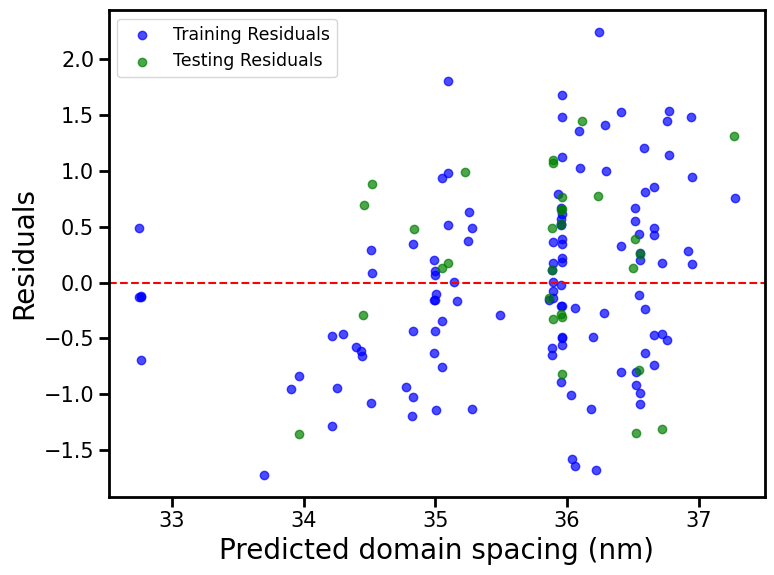

In [8]:
# Define the figure title
fig_title = f'{model_output}_residuals.png'

res_train = y_train - rfrtrain
res_test = y_test - rfreval

# set formatting for plots
%matplotlib inline
rc('text', usetex=False)
rc('mathtext', fontset='cm')
rc('xtick', labelsize=15)  
rc('xtick.major', size=7)   
rc('xtick.minor', size=4)
rc('xtick.major', width=2)
rc('xtick.minor', width=2)
rc('ytick.major', width=2)
rc('ytick.minor', width=2)
rc('ytick', labelsize=15)
rc('ytick.major', size=7)
rc('ytick.minor', size=4)
rc('axes', labelsize=15) 
rc('axes', linewidth=2) 
rc('font',family='sans serif')
rc('font', style='normal')
rc('font', weight='500')
rc('font', size='15')
rc('axes', labelweight='500')
rc('axes.spines', **{'right':True, 'top':True})   

# Create a residuals plot
plt.figure(figsize=(8, 6))
plt.scatter(rfrtrain, res_train, color='blue', alpha=0.7, label='Training Residuals')
plt.scatter(rfreval, res_test, color='green', alpha=0.7, label='Testing Residuals')
plt.axhline(y=0, color='red', linestyle='--', linewidth=1.5)
plt.xlabel("Predicted domain spacing (nm)", fontsize='20')
plt.ylabel("Residuals", fontsize='20')
# Set legend background color to white
legend = plt.legend(fontsize='12.5')
legend.get_frame().set_facecolor('white')

# Set the background color to white
plt.gca().set_facecolor('white')

# Remove gridlines
plt.grid(False)

# Add tickmarks to x and y axes
plt.tick_params(axis='both', which='both', reset=True, top=False, right=False)

# # Add black borders to the grid
plt.gca().spines['top'].set_color('black')
plt.gca().spines['bottom'].set_color('black')
plt.gca().spines['left'].set_color('black')
plt.gca().spines['right'].set_color('black')

plt.grid(False)
plt.tight_layout()
plt.savefig(output_path + fig_title, format='png')
plt.show()

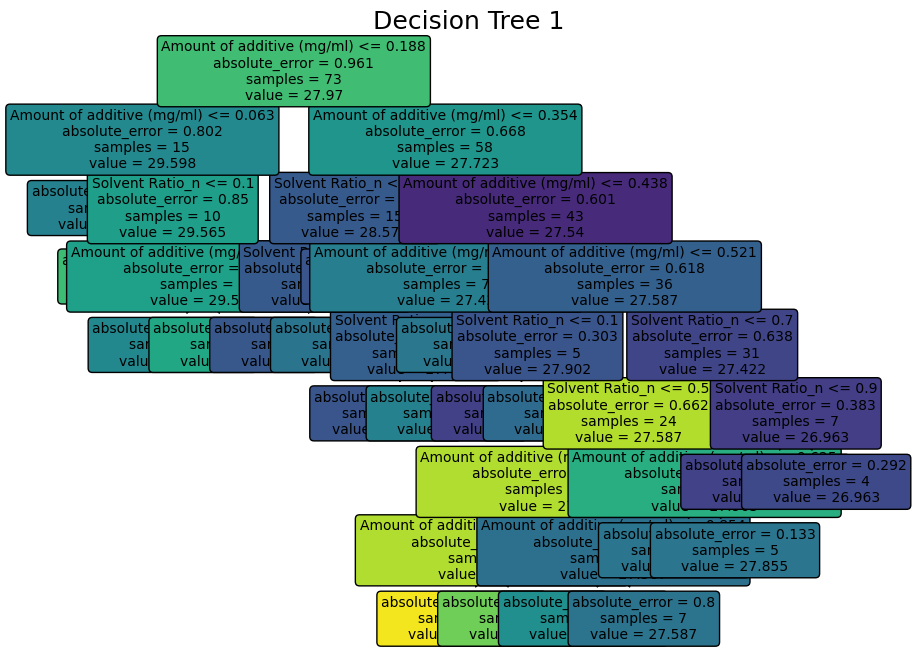

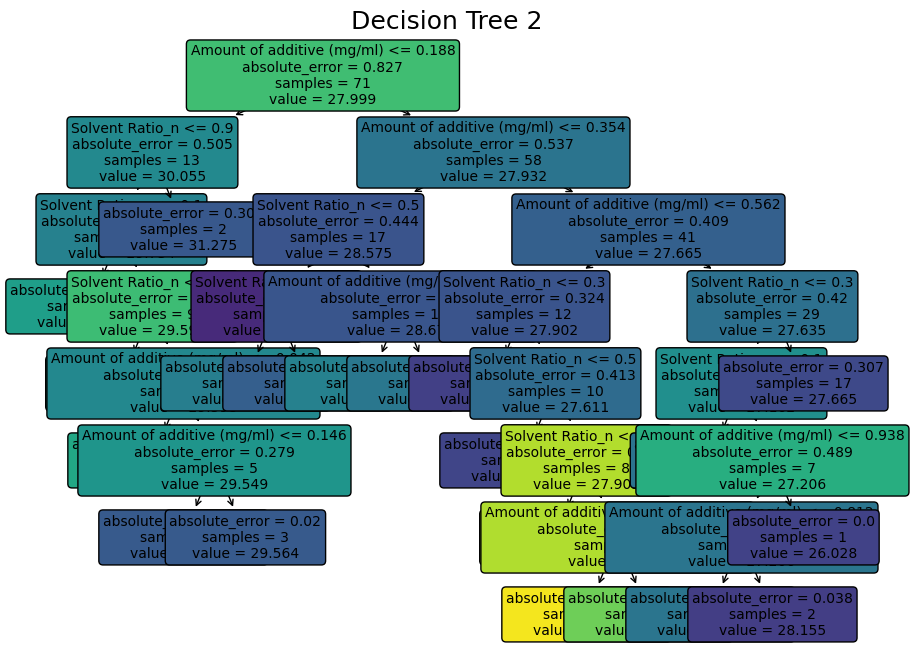

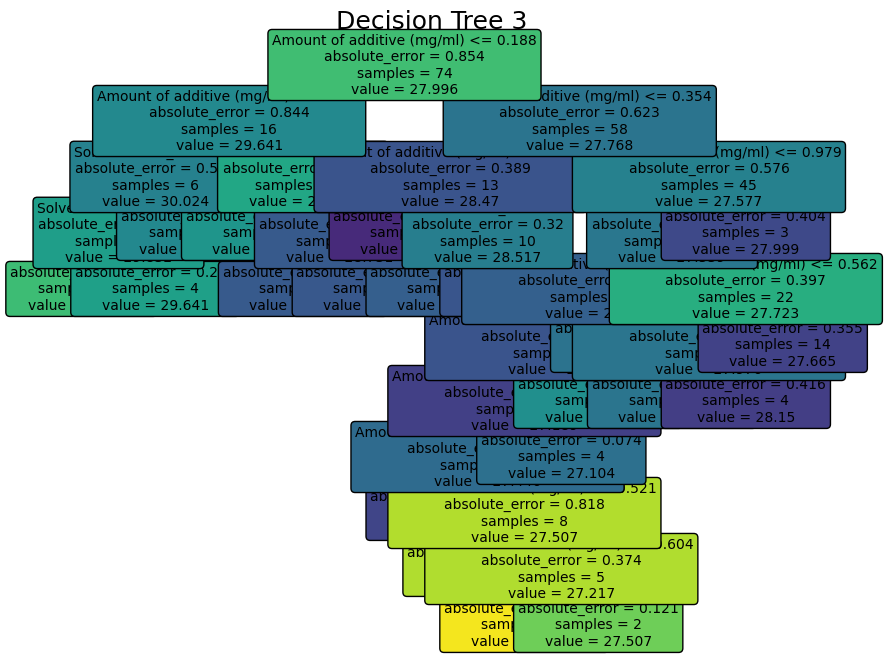

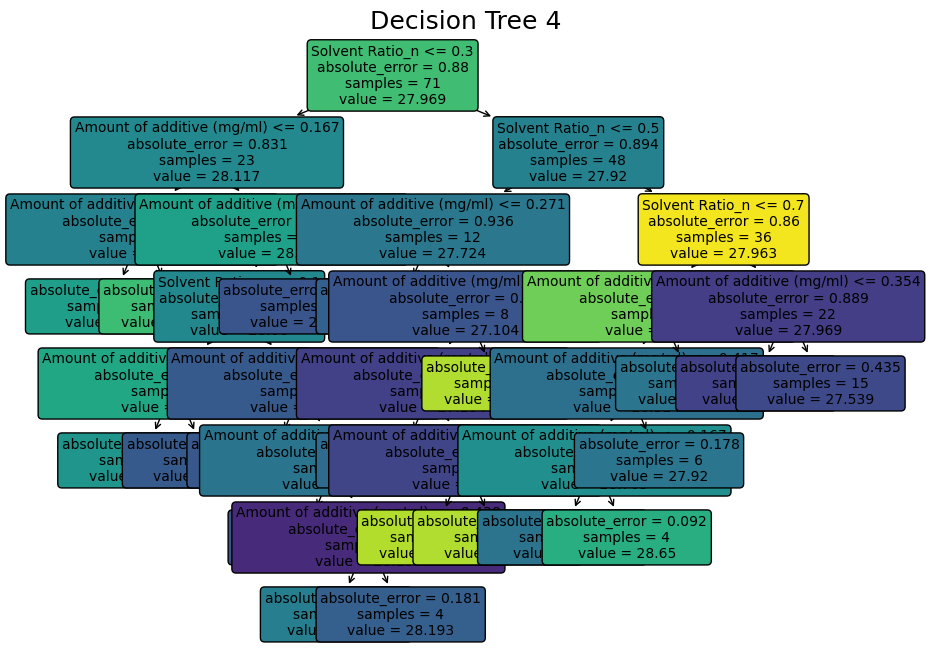

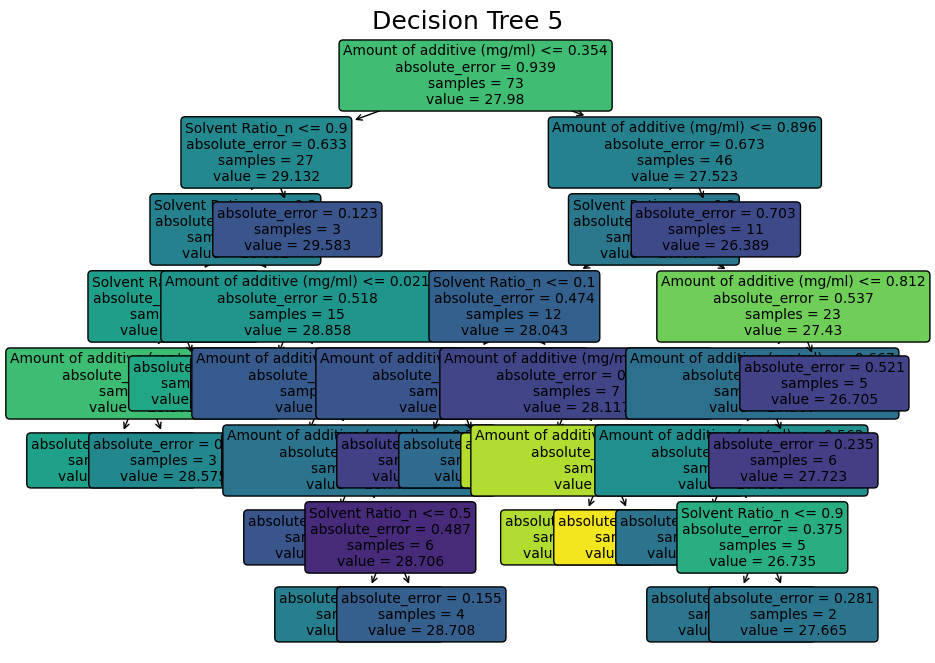

...

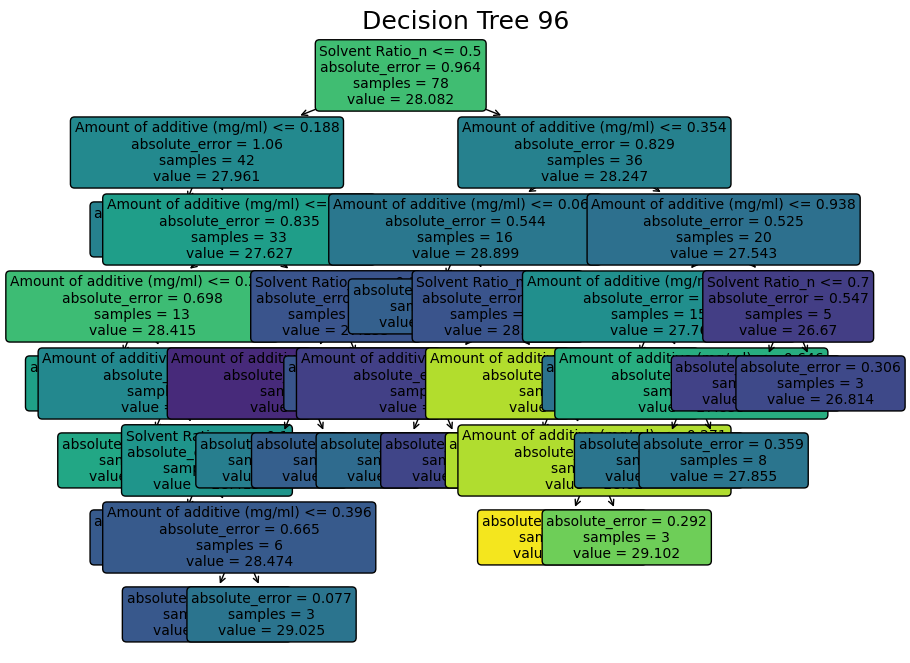

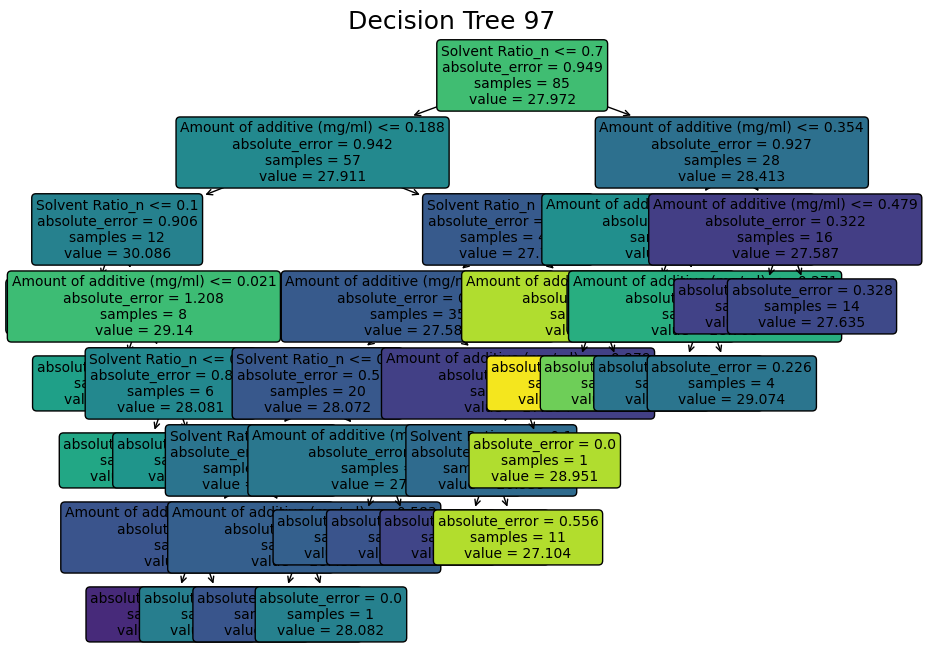

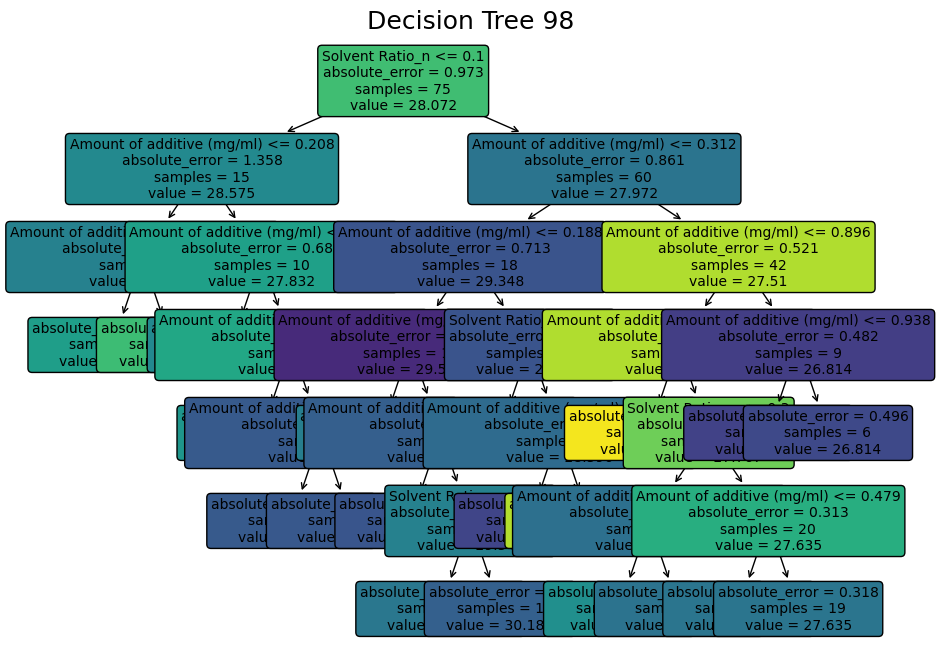

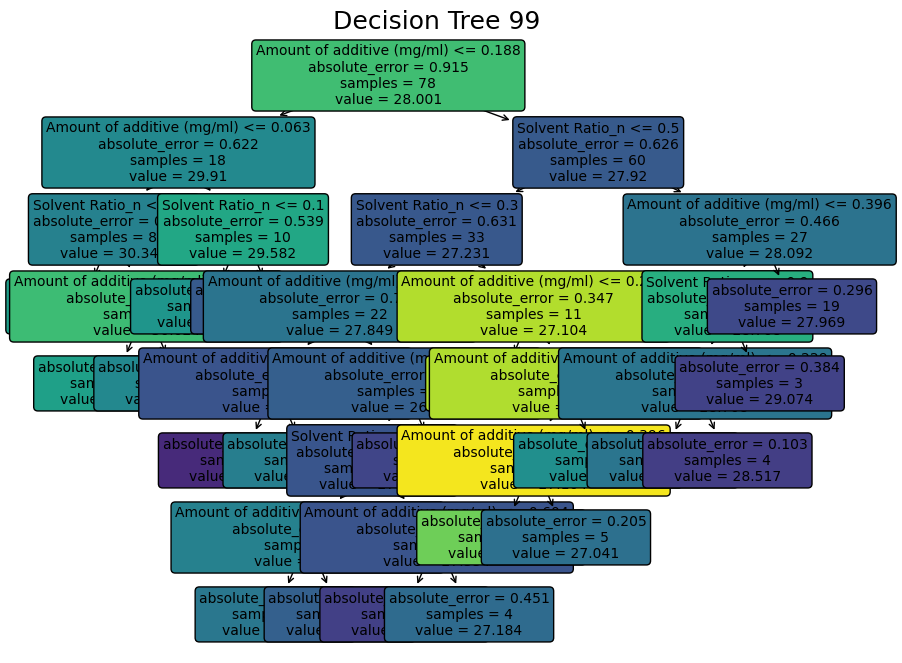

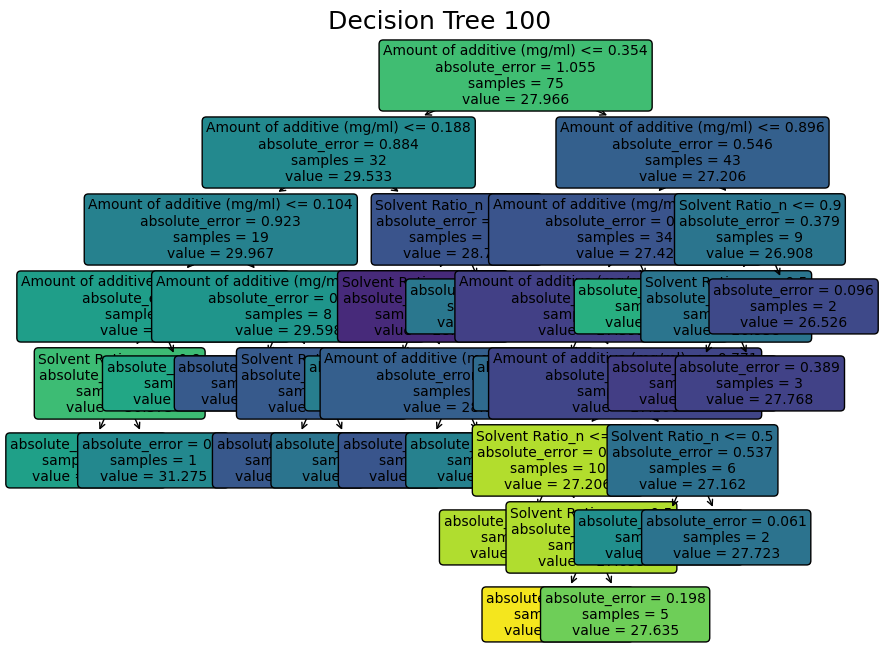

In [38]:
from sklearn.preprocessing import MinMaxScaler

# Normalize the target values
scaler = MinMaxScaler()
y_normalized = scaler.fit_transform(target.values.reshape(-1, 1)).flatten()

# Visualization for each tree
for i in range(len(best.estimators_)):
# for i in range(5):
    plt.figure(figsize=(10, 8))  # Adjust figure size as needed

    # Plot the decision tree
    ax = plt.gca()
    ax.set_facecolor('white')  # Set background color for the plot
    tree.plot_tree(best.estimators_[i], 
                   feature_names=inputs_n.columns,  # Provide feature names if available
                   filled=True,            # Fill nodes with colors
                   rounded=True,          # Round the nodes
                   fontsize=10)           # Adjust font size

    # Change colors of nodes based on normalized regression values
    for artist, impurity, value in zip(ax.get_children(), best.estimators_[i].tree_.impurity, y_normalized):
        color = plt.cm.viridis(value)  # You can use any colormap
        artist.get_bbox_patch().set_facecolor(color)
        artist.get_bbox_patch().set_edgecolor('black')

    plt.title(f"Decision Tree {i+1}")  # Set title for each tree
    plt.show()


In [91]:
import numpy as np

# Example NumPy array
numpy_array = np.array([1, 2, 3, 4, 5])

# Convert NumPy array to tuple
tuple_from_array = tuple(numpy_array)

# print("NumPy array:", numpy_array)
# print("Tuple from NumPy array:", tuple_from_array)
print(type(tuple_from_array))

<class 'tuple'>


[ 0  0  0  1  0 -2  1 -2  0 -2 -2  1 -2 -2 -2  0  0  1  1  1  1  0  0  0
  0 -2 -2 -2 -2 -2 -2 -2 -2  1 -2 -2 -2 -2 -2]


/tmp/ipykernel_227297/2514134485.py:38: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='Normalized Regression Values')


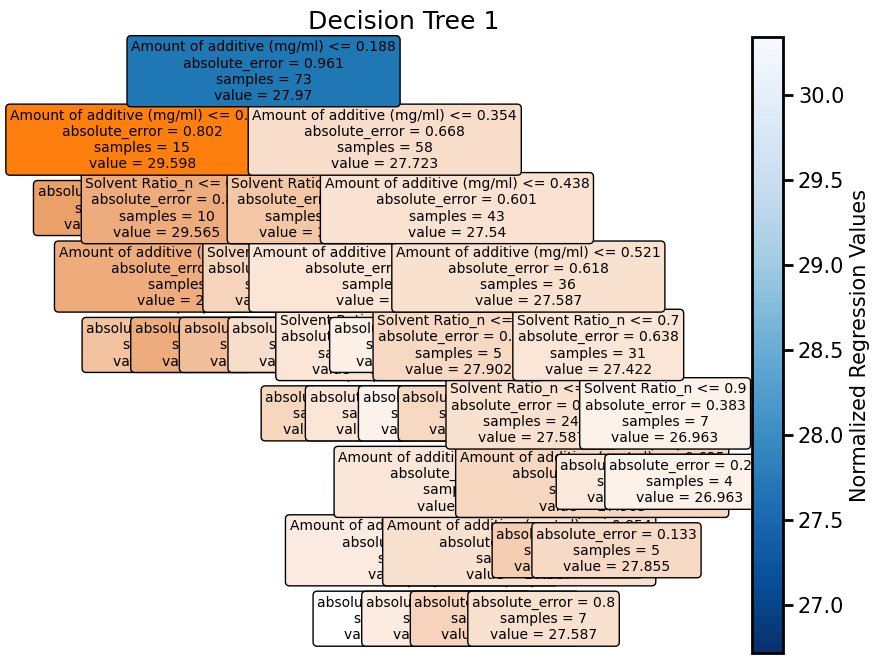

[ 0  1  0  1  0  1 -2 -2  1  1  1  1 -2  1  0 -2 -2 -2  0  0 -2 -2 -2 -2
  1 -2  1 -2  0 -2 -2 -2  0 -2  0 -2 -2 -2 -2]


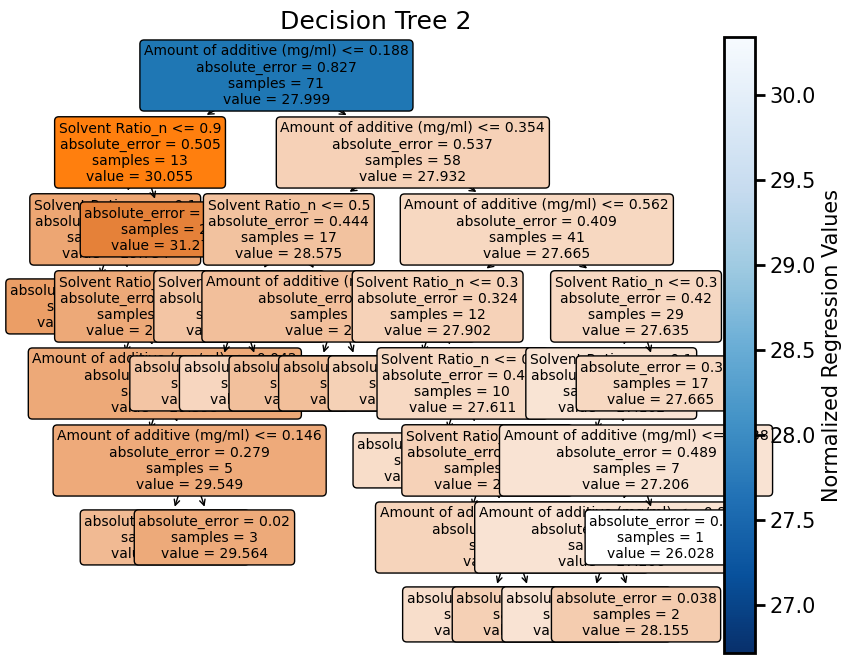

[ 0  0  0  0  0 -2  1  1 -2  0  0  1  1 -2  1 -2 -2  1 -2 -2 -2  0 -2  0
 -2  0 -2 -2 -2 -2  0 -2  0 -2 -2  0 -2 -2 -2]


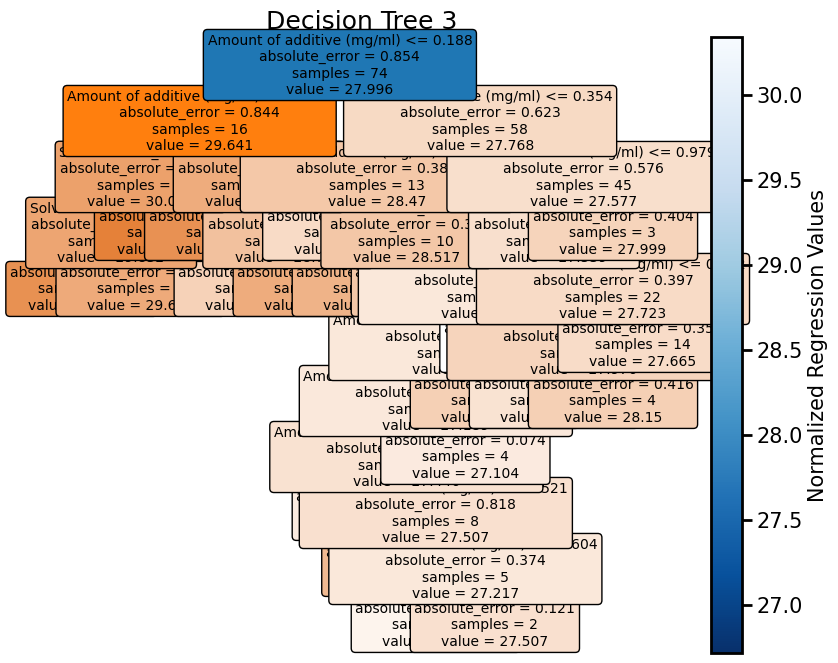

[ 1  0  1  0  0  1 -2  0  1 -2  0  0 -2 -2  0 -2 -2  0  0 -2 -2 -2  0 -2
  0 -2 -2 -2 -2  0  0 -2 -2  0 -2  0 -2 -2 -2]


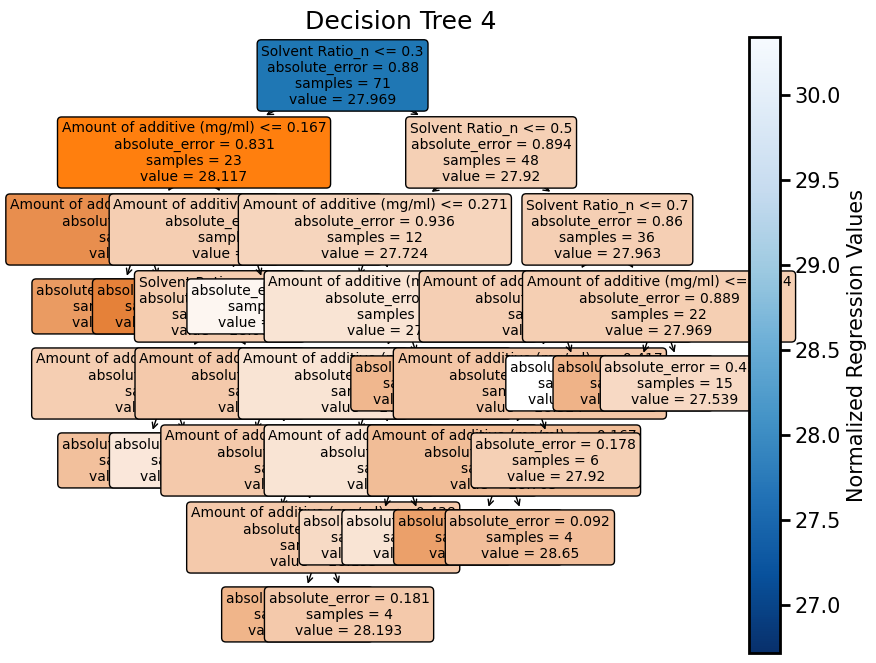

[ 0  1  0  1 -2  1  0  1 -2  0 -2  0 -2 -2  1 -2 -2  0  0 -2  0  1  0 -2
  0  0 -2 -2 -2 -2  0 -2 -2 -2  1 -2 -2 -2 -2]


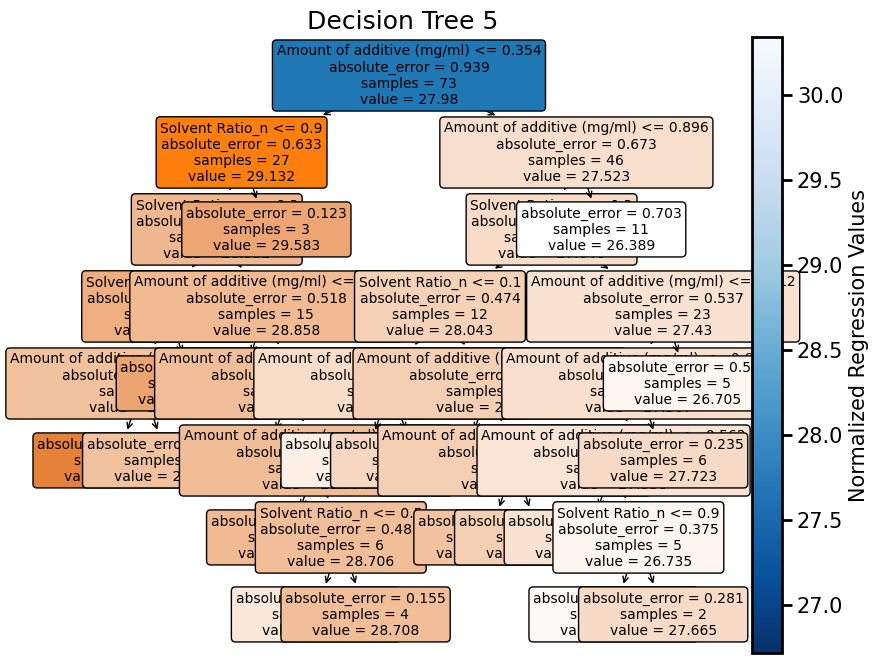

In [125]:
from sklearn.preprocessing import MinMaxScaler

reg_output = np.concatenate((rfrtrain, rfreval))
cmap = plt.cm.Blues
revmap = cmap.reversed()

# Visualization for each tree
for i in range(5):
    plt.figure(figsize=(10, 8))  # Adjust figure size as needed

    # Plot the decision tree
    ax = plt.gca()
    ax.set_facecolor('white')  # Set background color for the plot
    tree.plot_tree(best.estimators_[i], 
                   feature_names=inputs_n.columns,  # Provide feature names if available
                   filled=True,            # Fill nodes with colors
                   rounded=True,          # Round the nodes
                   fontsize=10)           # Adjust font size
    
    print(best.estimators_[i].tree_.feature)
    values = best.estimators_[i].tree_.value
    min_val = np.min(values)
    max_val = np.max(values)
    normalized_array = (values - min_val) / (max_val - min_val)
    
    # Change colors of nodes based on the feature used
    for node in best.estimators_[i].tree_.feature:
        if node != -2:  # -2 represents leaf nodes
            color = plt.cm.tab10(node)  # Assign color based on feature index
            ax.get_children()[node].get_bbox_patch().set_facecolor(color)
            ax.get_children()[node].get_bbox_patch().set_edgecolor('black')

    plt.title(f"Decision Tree {i+1}")  # Set title for each tree
    
    # Add color bar
    sm = plt.cm.ScalarMappable(cmap=revmap, norm=plt.Normalize(vmin=min(reg_output), vmax=max(reg_output)))
    sm.set_array(reg_output)
    plt.colorbar(sm, label='Normalized Regression Values')
    
    plt.show()
